In [1]:
## add the sys function part else there will be file loading errors.
import sys
import warnings
sys.path.insert(1,'../functions')
warnings.filterwarnings("ignore", category=DeprecationWarning) 

import numpy as np
import io_pipe
import nd_index
import lst
import plot_utils
from matplotlib import pyplot as plt
from matplotlib.colors import Normalize
import logging
from eolearn.io import get_available_timestamps
import pdb
import geopandas as gpd
import get_coord

from skimage.feature import blob_dog, blob_log, blob_doh
from skimage.color import rgb2gray
from sklearn.preprocessing import scale

/Users/sanchit/anaconda3/lib/python3.7/site-packages/eolearn/io/processing_api.py:176: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  ProcApiType("bool_mask", 'DN', 'UINT8', np.bool, FeatureType.MASK): [
/Users/sanchit/anaconda3/lib/python3.7/site-packages/dask/array/numpy_compat.py:19: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  np.divide(0.

In [2]:
import geopandas as gpd

In [3]:
berlin = gpd.read_file('../geojson/gemeinden_simplify200.geojson')

/Users/sanchit/anaconda3/lib/python3.7/site-packages/pandas/core/internals/construction.py:496: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if dtype != object and dtype != np.object:
/Users/sanchit/anaconda3/lib/python3.7/site-packages/pandas/core/indexes/base.py:411: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  elif issubclass(data.dtype.type, np.bool) or is_bool_dtype(data):


In [5]:
berlin['geometry']

0    POLYGON ((13.47551 52.66878, 13.47565 52.66628...
Name: geometry, dtype: geometry

In [6]:
interested_area = berlin.geometry.unary_union
bbox_berlin = interested_area.bounds

In [7]:
%matplotlib inline

In [8]:
config_dict = {'INSTANCE_ID': '46050bd7-c3d7-48ae-9eb0-778a3cc4e1f5',
            'CLIENT_ID': '1baa0f1c-f797-4c51-ad28-5ff0a9a6e399',
            'CLIENT_SECRET': '[7/{<L4(%^(lPkh%XrzOiIj-W.B{I@n1&{DH0WjM'}


In [9]:
vconfig = io_pipe.set_config(new_id=True,INSTANCE_ID=config_dict['INSTANCE_ID'],
                            CLIENT_ID= config_dict['CLIENT_ID'],
                            CLIENT_SECRET=config_dict['CLIENT_SECRET'])

In [10]:
year_range = range(2012,2019)
date_range = [1,30]
month_range = [5,9]

In [11]:
eopatch_data,vtimestamp = io_pipe.get_landsat8_range(aoi=bbox_berlin,config = vconfig,year_range=year_range,month=month_range,
                           date_range=date_range,maxcc=.2)

No image exists for the parameters: time interval ('2012-05-01', '2012-09-30'),cloud coverage: 0.2,


/Users/sanchit/anaconda3/lib/python3.7/site-packages/eolearn/core/eodata.py:738: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if not issubclass(value.dtype.type, (np.integer, np.bool, np.bool_, np.bool8)):


All the fetched image have corrupted data hence not added time_interval ('2016-05-01', '2016-09-30')


In [19]:
eopatch_data.shape

(14, 1823, 2319, 12)

In [25]:
## images of certain timestamp have just black value and others are just completely cloudy
## so need to be see why? for now just removing them.
bad_img_idx = [1,2,3,4,5,7,8]
required_idx = [i for i in range(eopatch_data.shape[0]) if i not in bad_img_idx]

In [27]:
vLST = nd_index.get_lst(eopatch_data)
vLST = vLST[required_idx]

../functions/nd_index.py:18: RuntimeWarning: invalid value encountered in true_divide
  ndi = np.divide((band_a - band_b + c), (band_a + band_b + c))


In [26]:
required_idx

[0, 6, 9, 10, 11, 12, 13]

In [29]:
## use datamask for plot/NDVI/LST.
vR = eopatch_data[:,:,:,3]
vG = eopatch_data[:,:,:,2]
vB = eopatch_data[:,:,:,1]
vImg = np.stack([vR,vG,vB],axis =3)
vImg = (vImg *(255/  np.max(vImg))).astype(np.uint8)
vImg = (vImg*(3.5/255))
vImg = vImg[required_idx]

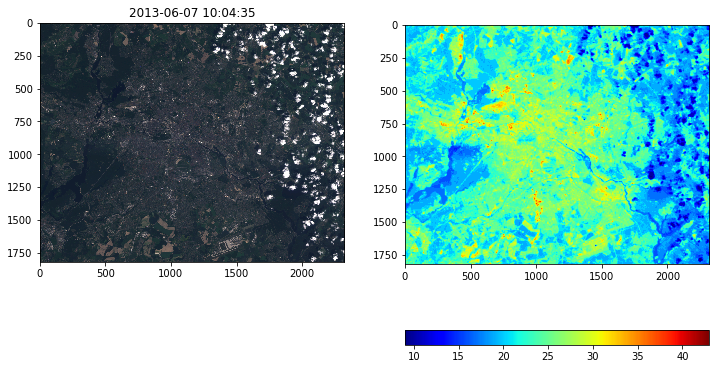

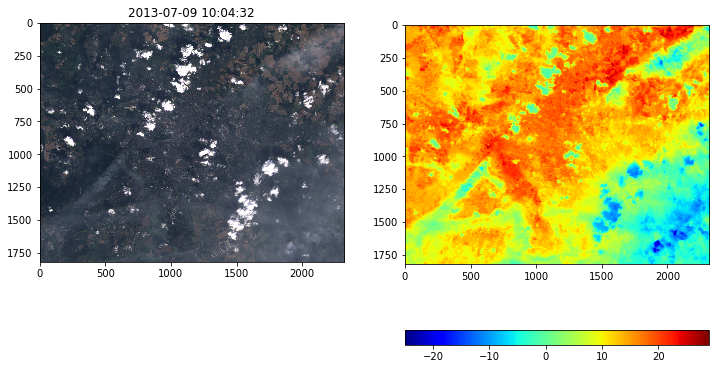

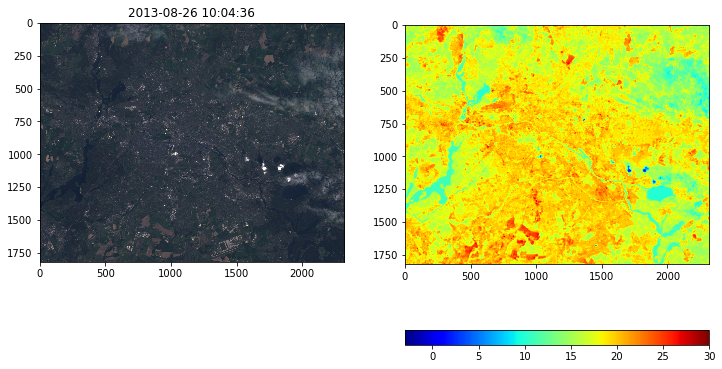

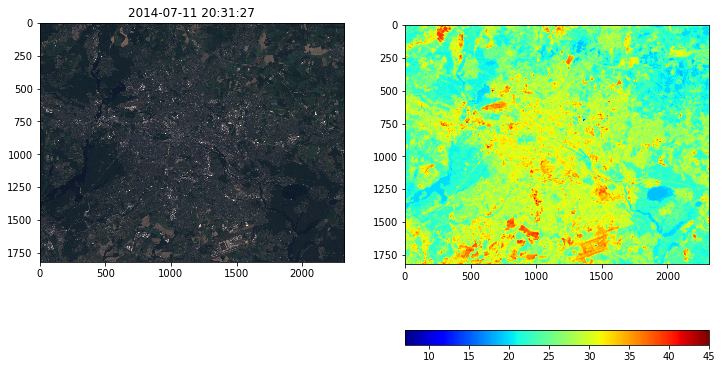

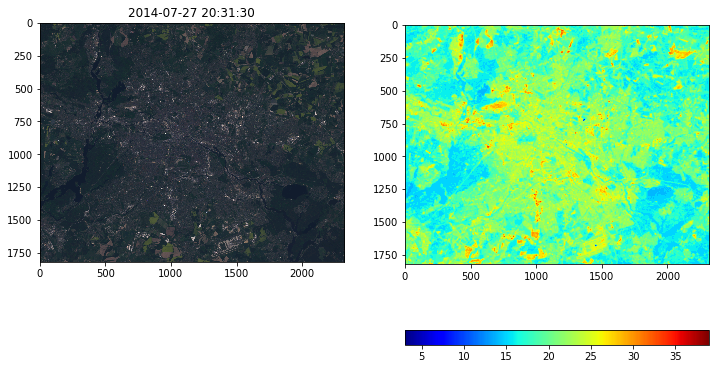

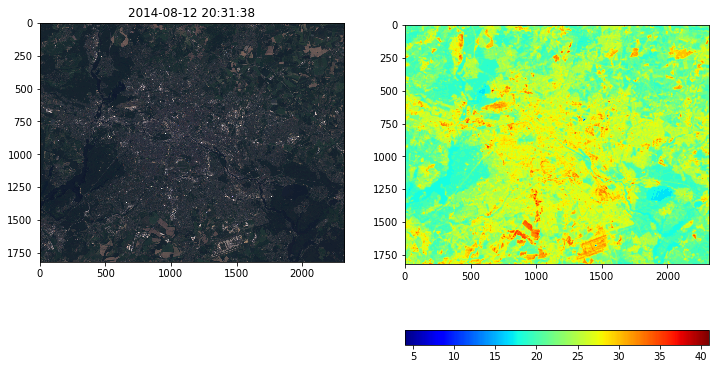

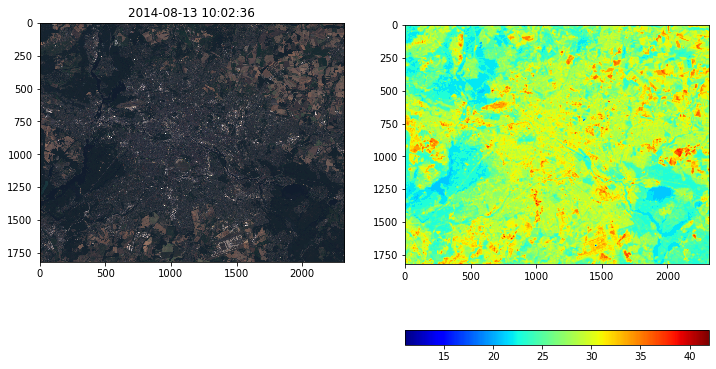

In [31]:
plot_utils.plot_all_LST(vImg,vLST,vtimestamp)

# Heat Island Detection

In [33]:
vdesired = vLST[6]
vOriginal = vImg[6]
vgray = rgb2gray(vdesired)
vgray = scale(vgray,axis=0, with_mean=True, copy=True)

In [36]:
plt.rcParams['figure.figsize'] = (30,30)

## Determinant of Hessian (DoH)¶

In [37]:
blobs = blob_doh(vgray, max_sigma=9, threshold=.1)

/Users/sanchit/anaconda3/lib/python3.7/site-packages/skimage/util/dtype.py:100: DeprecationWarning: Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.
  dtypeobj_out = np.dtype(dtype)
/Users/sanchit/anaconda3/lib/python3.7/site-packages/skimage/feature/peak.py:124: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  out = np.zeros_like(image, dtype=np.bool)


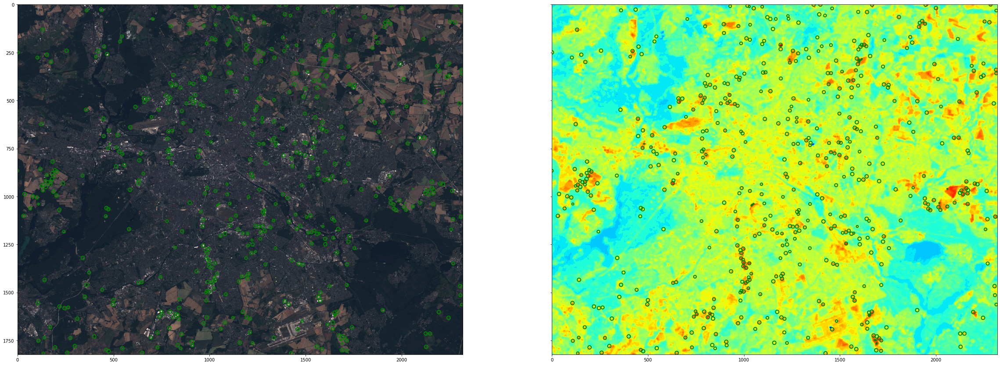

In [38]:
plot_utils.plot_islands(vOriginal,vdesired,blobs)

### Using Threshold on the basis avg temperature of a patch

In [39]:
# '''
# taking a patch of 30x30 pixel for each possible blob 
# and seeing if the average temperature is greater than 90th percentile of the temperature
# ''' 
# def threshold_hessian(desired,blobs,filter_size=10):
#     vfinal= []
#     vrange=filter_size
#     vper = np.percentile(desired,q=98)
#     for blob in blobs:
#         y,x,r = blob
#         y,x = y.astype(np.int64),x.astype(np.int64)
#     #     vmean = vdesired[x-vrange:x+vrange,y-vrange:y+vrange].mean()
#         vmean = desired[y-vrange:y+vrange,x-vrange:x+vrange].mean()
#         if vmean>vper:
#             vfinal.append(np.array([y,x,r]))
#     vfinal = np.array(vfinal)
#     return vfinal

In [40]:
vfinal = lst.threshold_hessian(vdesired,blobs)

/Users/sanchit/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:13: RuntimeWarning: Mean of empty slice.
  del sys.path[0]
/Users/sanchit/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


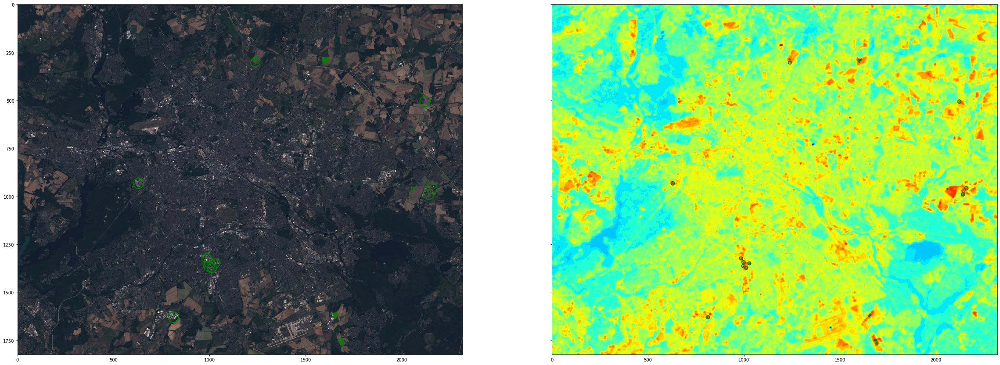

In [41]:
plot_utils.plot_islands(vOriginal,vdesired,vfinal,enhance_radius=True)

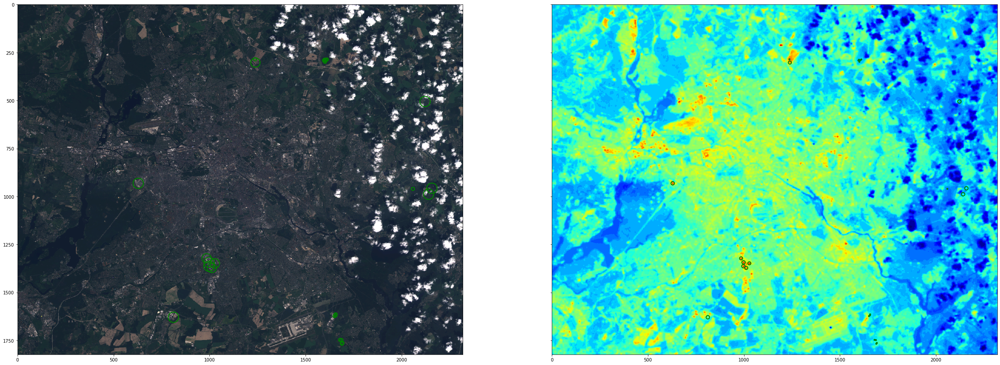

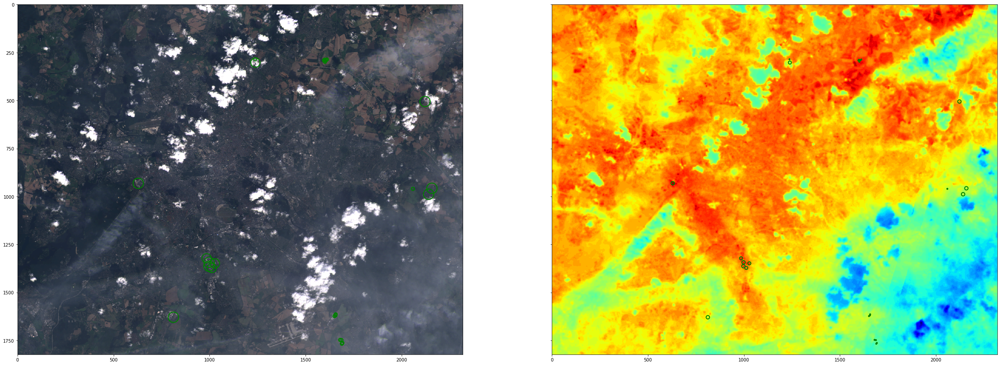

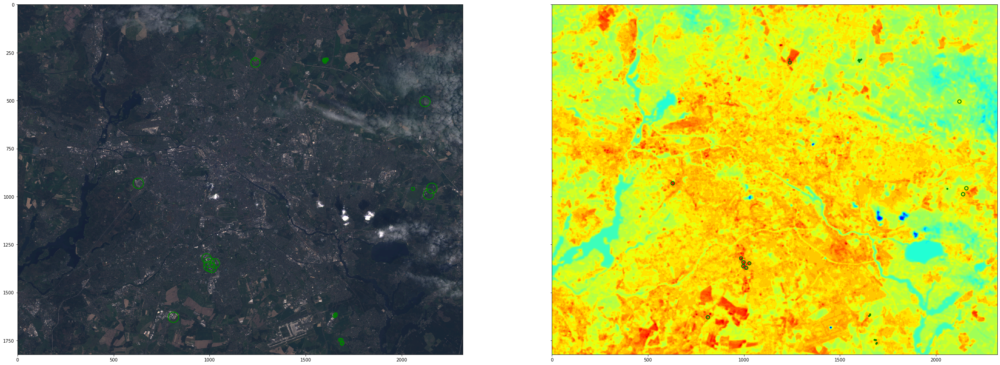

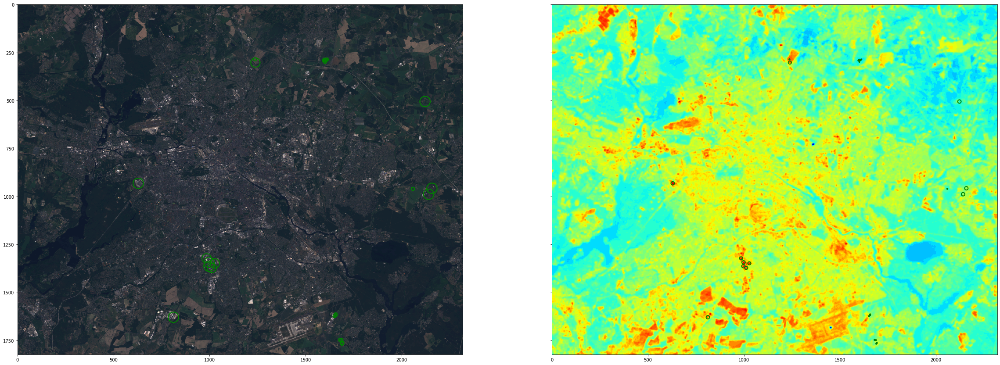

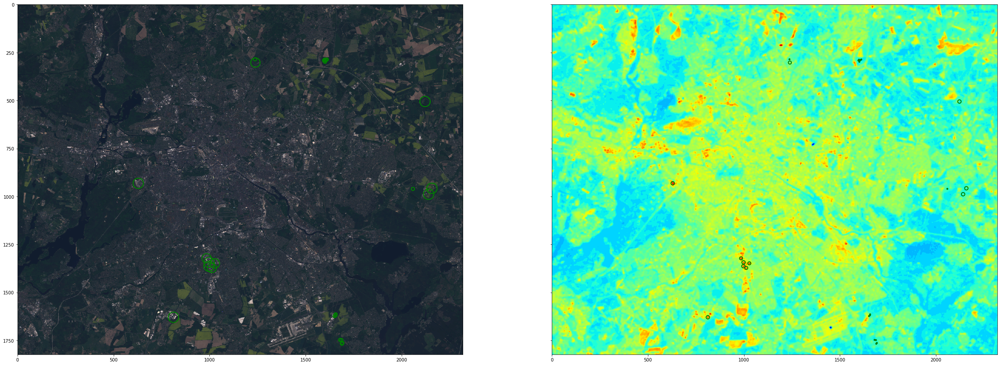

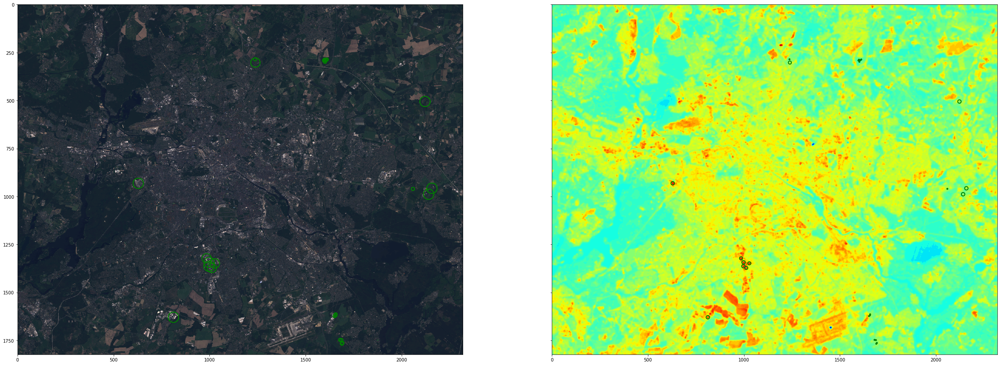

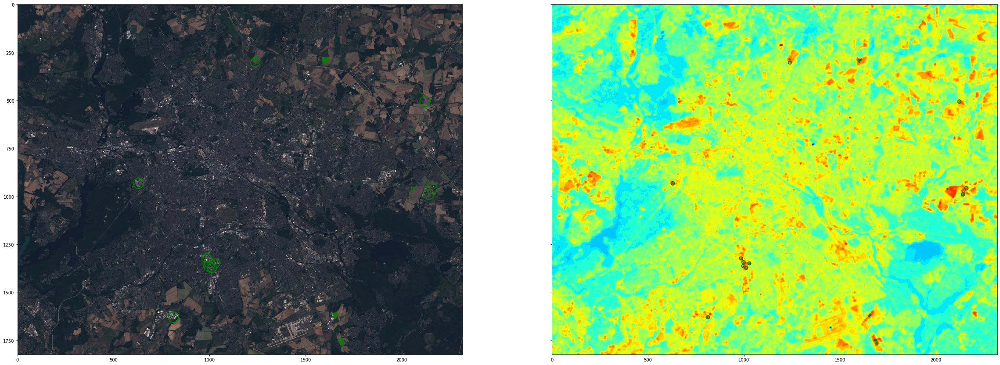

In [42]:
for i in range(vImg.shape[0]):
    plot_utils.plot_islands(vImg[i],vLST[i],vfinal,enhance_radius=True)

In [44]:
vM,_ = get_coord.get_coord_matrix(vImg.shape[2],vImg.shape[1],bbox_berlin)

In [ ]:
geo_blobs = get_coord.get_bbox(vM, vfinal)

In [48]:
geo_blobs

[BBox(((13.571647681964052, 52.3448940374492), (13.583231012436343, 52.352285372546575)), crs=CRS('4326')),
 BBox(((13.572516431749474, 52.34563317095894), (13.584099762221765, 52.353024506056315)), crs=CRS('4326')),
 BBox(((13.571068515440437, 52.34840492162046), (13.582651845912729, 52.35579625671783)), crs=CRS('4326')),
 BBox(((13.569041432607786, 52.34858970499789), (13.580624763080078, 52.355981040095266)), crs=CRS('4326')),
 BBox(((13.317683161359074, 52.37039414353515), (13.329266491831365, 52.37778547863253)), crs=CRS('4326')),
 BBox(((13.560643518015375, 52.37150284379976), (13.572226848487666, 52.378894178897134)), crs=CRS('4326')),
 BBox(((13.562091434324412, 52.3722419773095), (13.573674764796703, 52.379633312406874)), crs=CRS('4326')),
 BBox(((13.562381017586219, 52.37316589419667), (13.57396434805851, 52.38055722929405)), crs=CRS('4326')),
 BBox(((13.375599813720529, 52.41788347153581), (13.38718314419282, 52.42527480663318)), crs=CRS('4326')),
 BBox(((13.37125606479342, 